In [81]:
%load_ext autoreload
%autoreload 2

import sys
print(sys.version_info)

#sys.path.append('~/Dropbox/package_bkntis/bkntis')

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
sys.version_info(major=3, minor=10, micro=10, releaselevel='final', serial=0)


In [82]:
import pandas as pd
from pandas import DataFrame, Series

## 1 패키지 임포트

In [83]:
#  'import bkntis packgage
from bkntis import bk_ntis as bn
from bkntis.graph import bk_graph_plotly as bgp


## 2 데이터 로딩

In [84]:
# 파일 위치, ntis 파일이 위치한 경로를 입력해 줍니다.

# iMac
filename1 = '/Users/bk/Documents/ntis_python/ntis_1999_2021.pkl'

# MacBookPro
#filename1 = '/Users/bk/Downloads/ntis_1999_2021.pkl'

ntis1 = bn.NTIS(filename=filename1)

>> pre_treatment1_fund() : (컬럼생성) 정부연구비_억, 정부연구비_조, 연구비_등급 1/2/3/4, 보안과제
>> pre_treatment2_name_org() : 사업 부처명 정리 (컬럼생성)  사업_부처명2/3/4/m
-- 사업_부처명m : NTIS 에 입력되어 있는 사업_부처명은 2012년 기준으로 되어 있음. 이것을 2020년 기준으로 변경함{'미래창조과학부': '과학기술정보통신부', '범부처 사업': '다부처', '중소기업청': '중소벤처기업부', '지식경제부': '산업통상자원부', '교육과학기술부': '과학기술정보통신부', '국토해양부': '국토교통부'}
>> pre_treatment3_region() : 지역명 정리, (컬럼생성) 지역2, 지역3
>> pre_treatment4_security() : (컬럼생성) 보안과제2, 보안과제3
(참고 1) 보안과제2 :  일반    986409
보안      4156
Name: 보안과제2, dtype: int64
(참고 2) 보안과제3 :  일반    986409
보안      4156
Name: 보안과제3, dtype: int64
*** NTIS 객체 생성 : 15.9 초
date : 2023-07-11 16:26:54.912935


## 3 분석 A

In [85]:
# 분석 A1
import time 
t1 = time.time()

r1 = ntis1.analyis(kind='A1')
type(r1)

t2 = time.time()-t1
print(t2)

>>> analysis()
(1) draw null
* A1-1 데이터 비율(전체)
* A1-2 널 개수(전체)
* A1-3 널 비율(전체)
* A1-4 데이터 비율(연도별 : 1999~2021)
51.802313804626465


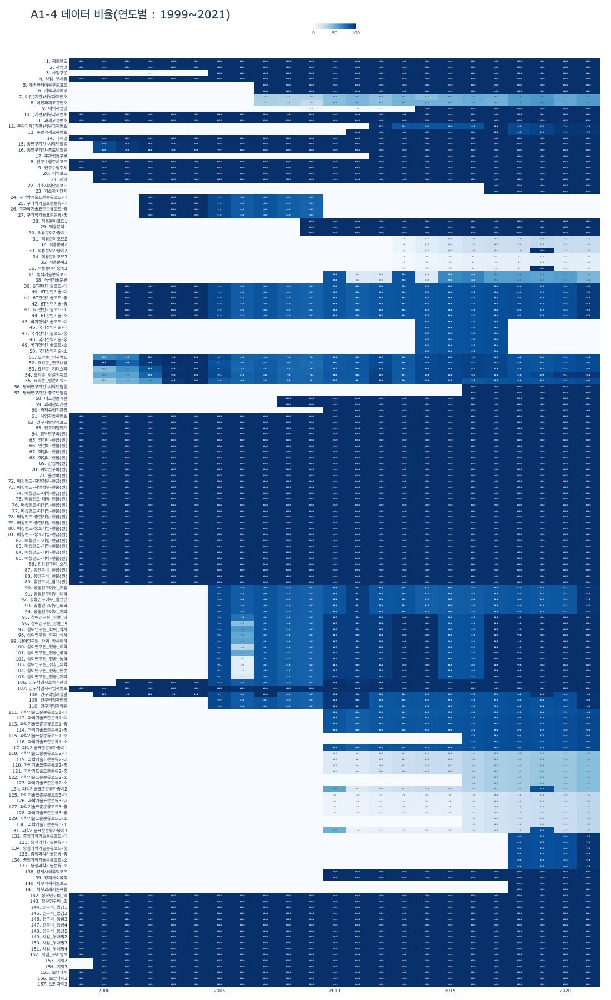

In [88]:
r1['A1'][4]['fig']

In [89]:
# 분석 A2
import time 
t1 = time.time()

ra2 = ntis1.analyis(kind='A2')
type(ra2)

t2 = time.time()-t1
print(t2)

>>> analysis()
(2) fund_trend1()
>>>
* A2-1 정부 연구개발 집행액과 과제수
* A2-2 정부 연구개발 집행액의 평균 및 중앙값
9.52208399772644


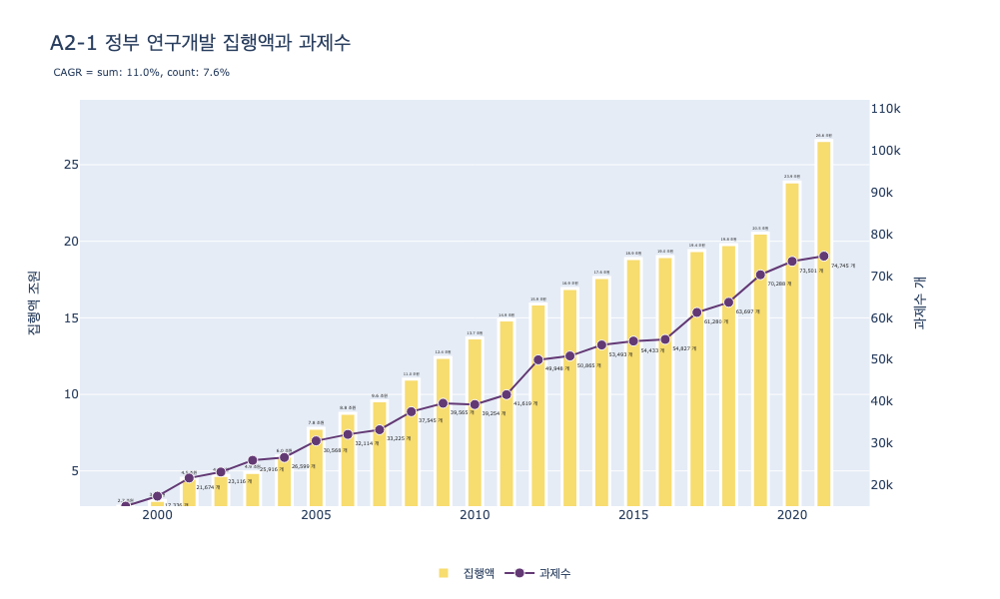

In [87]:
r1['A2'][1]['fig']

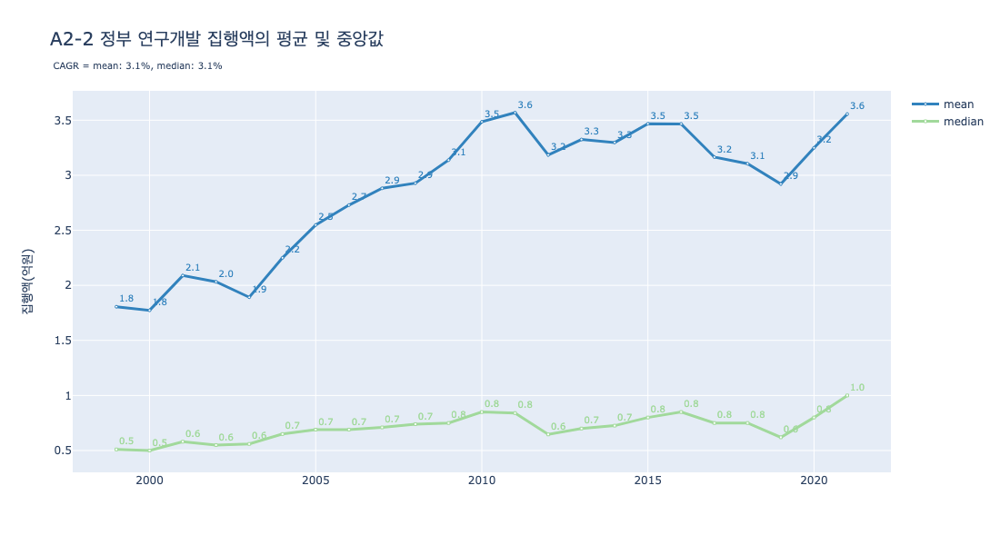

In [90]:
ra2['A2'][2]['fig']

In [91]:
# 분석 A3
import time 
t1 = time.time()

r1 = ntis1.analyis(kind='A3')
type(r1)

t2 = time.time()-t1
print(t2)

>>> analysis()
(3) fund_histogram()
* A3 정부연구비_억 Histogram 1 (전체)
* A3 정부연구비_억 Histogram 2 (10 억원 이하)
* A3 정부연구비_억 Histogram 3 (20 억원 이하)
* A3 정부연구비_억 Histogram 4 (100 억원 이하)
* A3 정부연구비_억 Histogram 5
25.650475025177002


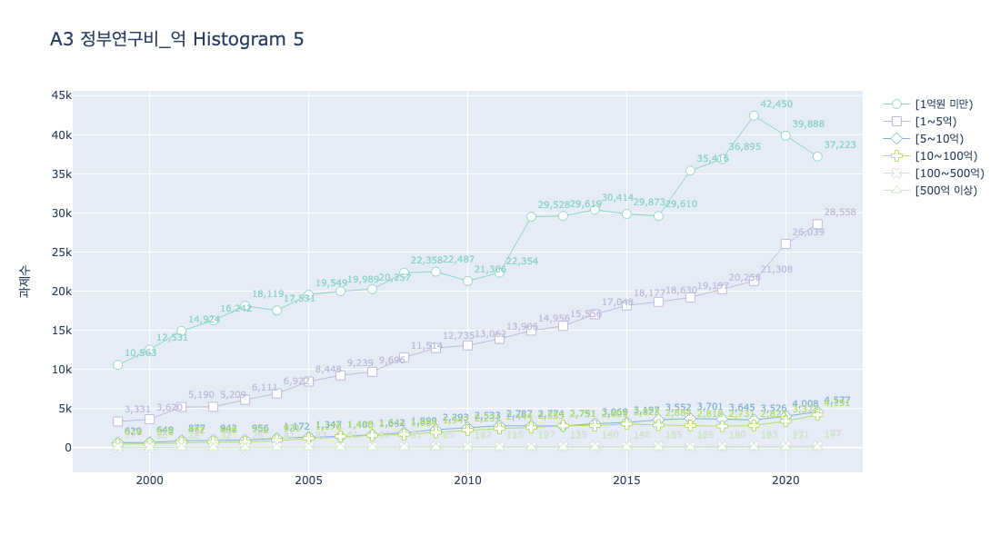

In [92]:
r1['A3'][5]['fig']

In [93]:
# 분석 A4
import time 
t1 = time.time()

r1 = ntis1.analyis(kind='A4')
type(r1)

t2 = time.time()-t1
print(t2)

>>> analysis()
(4) fund_boxplot()
* A4-정부연구비_억 Box Plot 제출년도 vs 정부연구비_억
22.21613383293152


In [74]:
r1.keys()

dict_keys(['A4'])

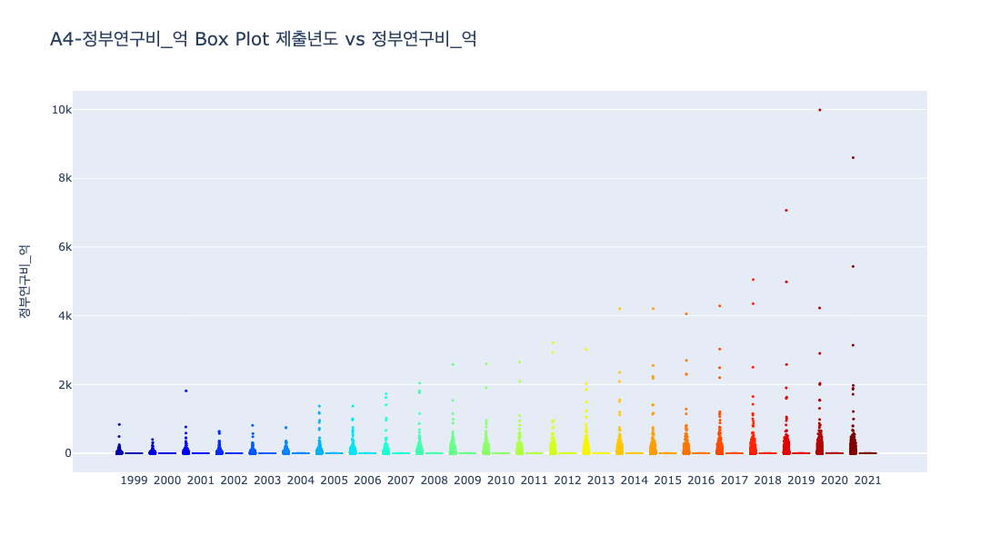

In [94]:
r1['A4'][1]['fig']

In [95]:
ntis1.show_target_columns()

* target columns >>
['사업_부처명', '사업_부처명m', '연구수행주체', '과제수행기관명', '지역', '지역2', '지역3', '6T관련기술-대', '과학기술표준분류1-대', '중점과학기술분류-대', '연구개발단계', '연구책임자성별', '보안과제3', '연구비_등급1', '연구비_등급2', '연구비_등급4']


In [105]:
df_temp = ntis1.df[ntis1.df['정부연구비(원)']>4e11]

In [106]:
df_temp.shape

(12, 157)

In [107]:
df_temp[['제출년도','사업명','사업_부처명', '과제명','정부연구비_억','보안과제3']]

,제출년도,사업명,사업_부처명,과제명,정부연구비_억,보안과제3
10363,2014,국방기술개발,방위사업청,ADD-핵심-기타,4209.54000,일반
40346,2015,국방기술개발,방위사업청,ADD-핵심-기타,4209.54000,일반
31521,2016,국방기술개발,방위사업청,ADD-핵심-기타,4055.02000,일반
59259,2017,국방기술개발,방위사업청,ADD-핵심-기타,4288.87000,일반
35193,2018,국방기술개발,방위사업청,ADD-핵심-기타,5054.18000,일반
35637,2018,항공기연구개발,방위사업청,한국형전투기(KF-X) 체계개발,4353.62000,일반
15729,2019,항공기연구개발,방위사업청,보안과제정보,7070.19460,보안
16042,2019,국방기술개발,방위사업청,ADD-핵심-기타,4985.29499,일반
11573,2020,항공기연구개발,방위사업청,보안과제정보,9987.99702,보안
11777,2020,국방기술개발,방위사업청,보안과제정보,4230.82764,보안


## 3 분석 B

In [92]:
ntis1.show_target_columns()

* target columns >>
['사업_부처명', '사업_부처명m', '연구수행주체', '과제수행기관명', '지역', '지역2', '지역3', '6T관련기술-대', '과학기술표준분류1-대', '중점과학기술분류-대', '연구개발단계', '연구책임자성별', '보안과제3', '연구비_등급1', '연구비_등급2', '연구비_등급4']


In [108]:
import time 
t1 = time.time()

r1 = ntis1.analyis(kind='B', target_columns=['사업_부처명m'], pdf_save=True)
type(r1)

t2 = time.time()-t1
print(t2)

>>> analysis()
*** 분석 B - 1 : 사업_부처명m
* 1B-0 사업_부처명m 년도별 유효 데이터 비율(%) 
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 0
initial v_0 == 0, so changed year_difference to 8
* 1Bm-1 사업_부처명m 연구비 추이
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 0
initial v_0 == 0, so changed year_difference to 8
* 1Bm-2 사업_부처명m 과제당 연구비(억원)


/Users/bk/Dropbox/package_bkntis/bkntis/util/bk_util.py:185: RuntimeWarning:

divide by zero encountered in long_scalars

/Users/bk/Dropbox/package_bkntis/bkntis/util/bk_util.py:185: RuntimeWarning:

divide by zero encountered in long_scalars



* 1Bm-3 사업_부처명m 연구비 추이(Bar)
* 1Bm-4 사업_부처명m 연구비 비율 추이(Bar)
* 1Bm_5 사업_부처명m 연구비 추이 (group)
* 1Bm_6 사업_부처명m 연구비 누적 추이 (stack)
* 1Bm-7 사업_부처명m 연구비 (1999~2021)
* 1Bm-8 사업_부처명m 연구비 (2017~2021)
* 1Bm-9 사업_부처명m 연구비(2017)
* 1Bm-10 사업_부처명m 연구비(2021)
len(fig_list)=11
 *** pdf/total__tab20c_2023_0711_1646_29.pdf was created ! *** 
25.651704788208008


In [109]:
r1.keys()

dict_keys(['1B'])

In [80]:
r1['1B'].keys()

dict_keys(['null', 'm'])

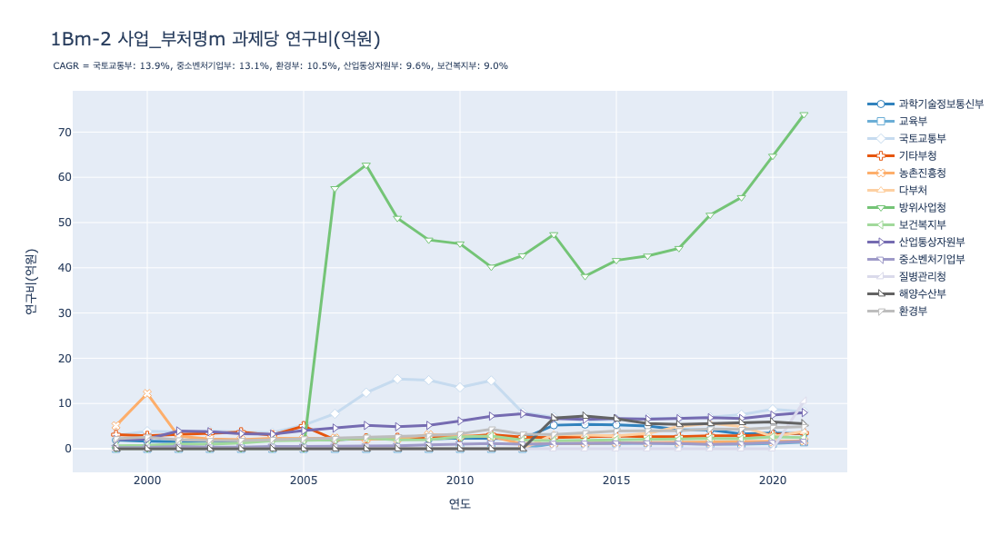

In [113]:
# 번호체계 
r1['1B']['m'][2]['fig']


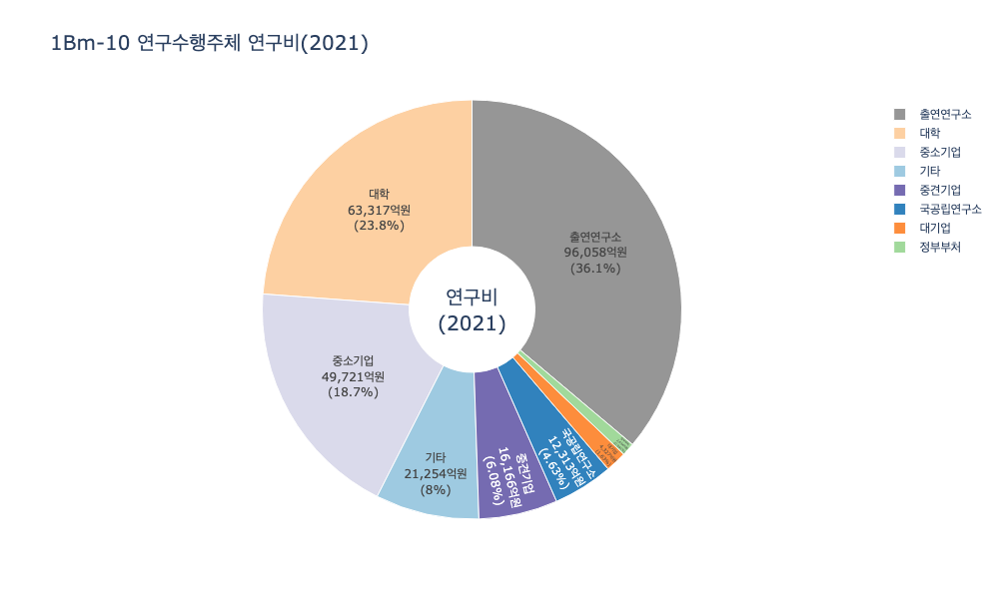

In [85]:
r1['1B']['m'][10]['fig']

In [117]:
ntis1.df['지역3'].value_counts()

수도권    472010
경상권    181310
충청권    173508
전라권     90702
강원      28504
기타      18818
제주       8457
해외       2299
Name: 지역3, dtype: int64

In [122]:
df_temp = ntis1.df[ntis1.df['제출년도']==1999]
df_temp['지역'].value_counts()

Series([], Name: 지역, dtype: int64)

In [120]:
df_temp = ntis1.df.groupby(['제출년도','지역'])['지역'].agg('count').unstack(fill_value=0)
df_temp

지역,강원도,경기도,경상남도,경상북도,광주광역시,기타,대구광역시,대전광역시,부산광역시,서울특별시,세종특별자치시,울산광역시,인천광역시,전라남도,전라북도,제주특별자치도,충청남도,충청북도,해외
제출년도,,,,,,,,,,,,,,,,,,,
2000,414,2513,728,474,531,483,877,2208,991,5423,0,115,634,264,500,99,639,439,4
2001,603,3469,1044,556,741,0,1098,2820,1377,6447,0,145,740,360,690,156,813,601,14
2002,587,4024,1181,891,791,62,841,2924,1411,6615,0,213,664,349,750,217,918,678,0
2003,741,4118,1290,723,911,33,1226,3045,1656,7894,0,188,887,465,839,244,933,723,0
2004,772,4074,1434,778,989,121,1364,3312,1636,7569,0,257,786,460,926,269,1126,726,0
2005,754,4754,1567,1237,986,1943,933,3399,1675,8636,0,241,832,602,879,288,1041,767,34
2006,817,5503,1560,1196,1090,657,1105,3562,1791,10200,0,241,860,508,887,253,1068,777,39
2007,893,5270,1490,1372,1231,680,1362,3624,1732,10270,0,335,940,567,1024,307,1189,890,49
2008,1137,5952,1504,1482,1341,2038,1499,3902,1870,10940,0,338,1112,720,1101,302,1269,950,88


In [114]:
import time 
t1 = time.time()

# '사업_부처명m','연구수행주체',

r1 = ntis1.analyis(kind='B', target_columns=['지역2'], pdf_save=True)
type(r1)

t2 = time.time()-t1
print(t2)

>>> analysis()
*** 분석 B - 1 : 사업_부처명m
* 1B-0 사업_부처명m 년도별 유효 데이터 비율(%) 
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 0
initial v_0 == 0, so changed year_difference to 8
* 1Bm-1 사업_부처명m 연구비 추이
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 8
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 0
initial v_0 == 0, so changed year_difference to 8
* 1Bm-2 사업_부처명m 과제당 연구비(억원)
* 1Bm-3 사업_부처명m 연구비 추이(Bar)
* 1Bm-4 사업_부처명m 연구비 비율 추이(Bar)
* 1Bm_5 사업_부처명m 연구비 추이 (group)
* 1Bm_6 사업_부처명m 연구비 누적 추이 (stack)
* 1Bm-7 사업_부처명m 연구비 (1999~2021)
* 1Bm-8 사업_부처명m 연구비 (2017~2021)
* 1Bm-9 사업_부처명m 연구비(2017)
* 1Bm-10 사업_부처명m 연구비(2021)


/Users/bk/Dropbox/package_bkntis/bkntis/util/bk_util.py:185: RuntimeWarning:

divide by zero encountered in long_scalars

/Users/bk/Dropbox/package_bkntis/bkntis/util/bk_util.py:185: RuntimeWarning:

divide by zero encountered in long_scalars



len(fig_list)=11
*** 분석 B - 2 : 연구수행주체
* 2B-0 연구수행주체 년도별 유효 데이터 비율(%) 
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 8
* 2Bm-1 연구수행주체 연구비 추이
initial v_0 == 0, so changed year_difference to 15
initial v_0 == 0, so changed year_difference to 8
* 2Bm-2 연구수행주체 과제당 연구비(억원)
* 2Bm-3 연구수행주체 연구비 추이(Bar)
* 2Bm-4 연구수행주체 연구비 비율 추이(Bar)
* 2Bm_5 연구수행주체 연구비 추이 (group)
* 2Bm_6 연구수행주체 연구비 누적 추이 (stack)
* 2Bm-7 연구수행주체 연구비 (1999~2021)
* 2Bm-8 연구수행주체 연구비 (2017~2021)
* 2Bm-9 연구수행주체 연구비(2017)
* 2Bm-10 연구수행주체 연구비(2021)
len(fig_list)=11
*** 분석 B - 3 : 지역2
* 3B-0 지역2 년도별 유효 데이터 비율(%) 


KeyError: 1999

## (참고) 컬러맵

https://plotly.com/python/discrete-color/

디폴트 : tab20c
기타 : Set3, jet

'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'winter', 'winter_r'
    

## 3. 분석 D

In [123]:
# iMac
filename_p = '/Users/bk/Documents/ntis_python/performance_1_paper_sci.pkl'

In [124]:
ntis1.import_performance_data(filename=filename_p)

* imported 931,716개 임포트 완료하였습니다.
* 전체 논문(931,716건) 중 보안과제의 논문 8,437건(0.9%)과 기여율 0% 논문 192,538건(20.7%)을 제외한 논문 730,741건(78.4%)을 분석 대상으로 하였다.
* 전체 (931716, 26) -> 보안과제, 기여율 0 % 이상 논문 (730741, 26))


In [125]:
ntis1.df_performance1b.shape

(730741, 26)

In [126]:
df = ntis1.df_performance1b
df.columns

Index(['성과발생년도', '성과발생부처', '성과사업ID', '성과사업명', '세부성과관리번호', 'NTIS_성과ID',
       'KISTEP_성과ID', '검증결과', '검증내역', 'SCI여부(입력시)', '학술지명', '논문명', 'ISBN',
       'P-ISSN', 'E-ISSN', '주저자명', '권(volume)', '호(issue)', '시작페이지', '논문번호',
       'DOI/url', '기여율(확정)', '과제수행년도', '과제고유번호', '(기관)세부과제번호', '과제명-국문'],
      dtype='object')

In [127]:
df['성과발생년도']=df['성과발생년도'].astype(int)
df['성과발생년도'].value_counts().sort_index()

2007    26191
2008    31212
2009    32684
2010    34578
2011    39386
2012    41935
2013    40932
2014    50975
2015    51626
2016    54603
2017    59133
2018    62952
2019    62910
2020    67915
2021    73709
Name: 성과발생년도, dtype: int64

In [128]:
df['과제수행년도']=df['과제수행년도'].astype(int)
df['과제수행년도'].value_counts().sort_index()

2000       11
2001       33
2002      171
2003      519
2004     1618
2005     3531
2006    16602
2007    21078
2008    28123
2009    32410
2010    31933
2011    41496
2012    42365
2013    42270
2014    54326
2015    53951
2016    52334
2017    59920
2018    54358
2019    64569
2020    64079
2021    65044
Name: 과제수행년도, dtype: int64

<Axes: >

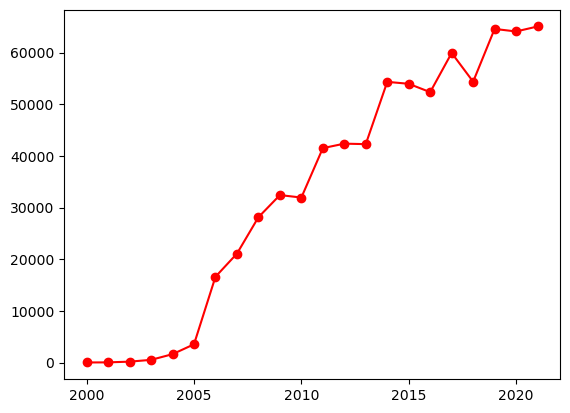

In [129]:
df['과제수행년도'].value_counts().sort_index().plot(marker='o', color="#ff0000")

In [130]:
df['검증결과'].value_counts()

성공    730741
Name: 검증결과, dtype: int64

### 논문비율

In [131]:
df['논문비율'] = df['기여율(확정)']/100
df['논문비율']

10       1.000000
12       1.000000
13       1.000000
14       1.000000
15       1.000000
           ...   
84151    0.500000
84152    1.000000
84153    1.000000
84154    1.000000
84155    0.333333
Name: 논문비율, Length: 730741, dtype: float64

In [132]:
s1 = df.groupby(['성과발생년도'])['논문비율'].agg('sum')
s1.name='성과발생년도 기준'

In [133]:
s2 = df.groupby(['과제수행년도'])['논문비율'].agg('sum')
s2.name = '과제수행년도 기준'

In [134]:
dfg = DataFrame([s1,s2])
dfg2= dfg.loc[:,2010:2021]
dfg2

,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
성과발생년도 기준,23421.993905,25947.290476,28279.083333,26738.714286,34688.460381,35329.024864,36949.323810,38548.996032,40786.971429,41503.188889,44216.536508,47940.496905
과제수행년도 기준,21513.860120,27438.326977,28508.665195,27497.485079,37000.732365,36687.807180,35095.505285,39168.571197,35385.311032,42570.018283,41769.977734,42272.150418


* D1 성과발생년도별 및 과제수행년도별 논문수


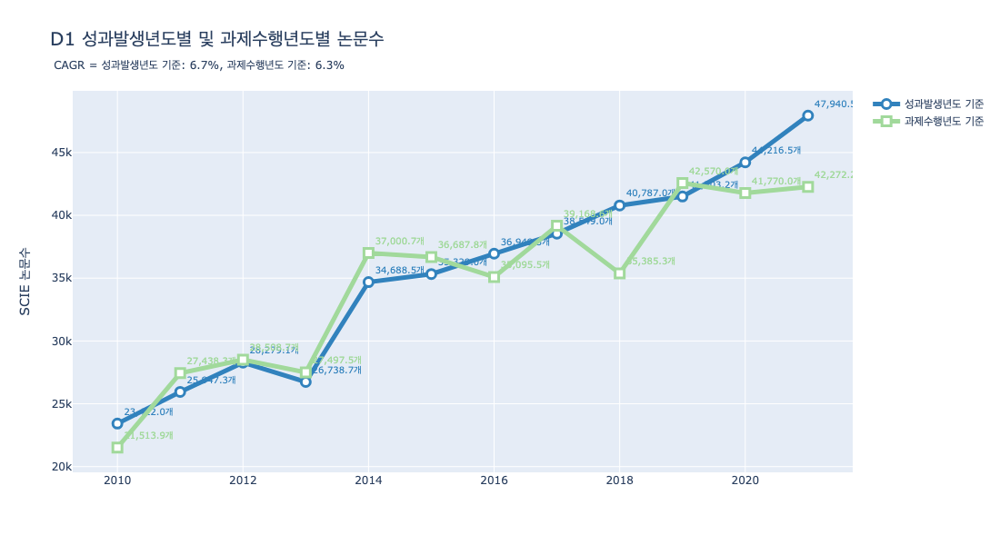

In [136]:
fig = bgp.make_graph_line(dfg2, precision=1, unit='개', 
                    node_size=10, 
                    title='D1 성과발생년도별 및 과제수행년도별 논문수', title_font_size=20, 
                    yaxes_title='SCIE 논문수', line_width=5, 
                    color_map='tab20c', 
                    marker_color="#ffffff",
                    marker_line_width=3,
                    cagr=True, text_cagr_font_size=12,
                    figsize=(800,600))
fig

In [211]:
return_dic={}
return_dic['paper']={'df':dfg2, 'fig':fig}

## 성과발생부처별 정리

In [66]:
# 부처명 조정 함수 

def change_dp_name(x='', dp_no=1, etc_no=1):
    
    dic_1 = {'미래창조과학부': '과학기술정보통신부',
            '중소기업청': '중소벤처기업부',
            '국무총리실': '국무조정실',
            '범부처 사업': '다부처'}
    
    dic_2 = {'미래창조과학부': '과학기술정보통신부',
             '국무총리실': '국무조정실',
             '농림수산식품부': '농림축산식품부',
             '국민안전처': '행정안전부',
             '범부처 사업': '다부처',
             '소방방재청': '소방청',
             '식품의약품안전청': '식품의약품안전처',
             '중소기업청': '중소벤처기업부',
             '지식경제부': '산업통상자원부',
             '외교통상부': '외교부',
             '행정자치부': '행정안전부',
             '안전행정부': '행정안전부',
             }

    dic_m = { '과학기술부': '과학기술정보통신부',
             '미래창조과학부': '과학기술정보통신부',
             '정보통신부':  '과학기술정보통신부',
             '교육과학기술부': '과학기술정보통신부',
             
             '교육인적자원부':'교육부',
             
             '농림부': '농림축산식품부',
             '농림수산식품부':'농림축산식품부',
             
             '범부처 사업': '다부처',
             '중소기업청': '중소벤처기업부',
             '지식경제부': '산업통상자원부',
             '산업자원부': '산업통상자원부',
            
             '국토해양부': '국토교통부',
             '건설교통부': '국토교통부',
             }

    etc_dept1 = ['국민안전처', '행정안전부', '행정자치부', '고용노동부', '새만금개발청', '인사혁신처',
                '통일부', '공정거래위원회', '행정중심복합도시건설청', '법무부', '외교부',
                '여성가족부', '법제처', '기획재정부', '소방청', '경찰청',
                '해양경찰청', '특허청', '문화재청', '국방부',
                '식품의약품안전처', '문화체육관광부', '원자력안전위원회']

    etc_dept2 = ['국민안전처', '행정안전부', '행정자치부', '고용노동부', '새만금개발청', '인사혁신처',
                 '통일부', '공정거래위원회', '행정중심복합도시건설청', '법무부', '외교부',
                 '여성가족부', '법제처', '기획재정부', '소방청', '경찰청',
                 '해양경찰청', '특허청', '문화재청', '국방부',
                 '식품의약품안전처', '문화체육관광부', '원자력안전위원회']
    
    etc_dept_m = [
                  '경찰청',
                  '고용노동부', '공정거래위원회', '국가과학기술위원회', '국가청소년위원회', 
                    '국무조정실', '국무총리실', 
                    '국민안전처', '국방부', '기상청', '기획재정부', 
                  #  '농림수산식품부', '농림축산식품부', '농림부',
                    '질병관리청',
                    '문화재청', '문화체육관광부', 
                    '방송통신위원회', 
                    '법무부', '법제처', '산림청', '새만금개발청', '소방방재청', '소방청',
                    '식품의약품안전처', '식품의약품안전청', '안전행정부', 
                    '여성가족부', '외교부', '외교통상부', '원자력안전위원회', '인사혁신처', 
                    '통일부', 
                  # '특허청',
                    '해양경찰청', '행정안전부', '행정자치부',
                    '행정중심복합도시건설청'   ]
    
    match dp_no :
        case 1 :
            dic_dp = dic_1
        case 2 :
            dic_dp = dic_2
        case 'm' :
            dic_dp = dic_m
        case __:
            dic_dp = {}
            #print("not matching")
    match etc_no : 
        case 1 :
            etc_dp = etc_dept1
        case 2 :
            etc_dp = etc_dept2
        case 'm':
            etc_dp = etc_dept_m
        case __:
            #print("etc not matching")
            etc_dp = {}
        
    if x in dic_dp.keys():
        return dic_dp[x]
    elif x in etc_dp :
        return '기타부청'
    else:
        return x 
    


In [68]:
df['성과발생부처2'] = df['성과발생부처'].map(lambda x : change_dp_name(x, dp_no='m', etc_no='m'))
#df_raw['성과발생부처3'] = df_raw['성과발생부처'].map(lambda x : change_name3(x) )

df1 = df.groupby(['성과발생부처2','성과발생년도'])['논문비율'].agg('sum').unstack(fill_value=0)
df1.index
df1.style.format("{:,.0f}")

성과발생년도,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
성과발생부처2,,,,,,,,,,,,,,,
과학기술정보통신부,"8,738","17,068","18,017","16,873","18,984","20,795","14,359","16,358","17,129","18,223","19,457","20,788","21,160","24,294","26,850"
교육부,"6,666",0,0,0,0,0,"5,941","11,103","10,790","10,335","10,807","11,518","12,665","11,767","12,617"
국토교통부,75,279,282,289,265,396,112,158,274,337,399,394,392,425,430
기타부청,117,177,207,325,472,500,362,496,460,576,592,666,611,689,758
농림축산식품부,154,225,249,384,436,513,489,465,518,547,567,444,458,573,357
농촌진흥청,410,457,490,607,613,918,993,"1,084",964,"1,072","1,017",806,777,872,709
다부처,0,0,0,0,0,0,10,40,87,114,116,180,227,321,608
방위사업청,35,65,116,94,82,126,105,31,128,113,56,95,78,118,86
보건복지부,768,"1,112","1,122","1,193","1,253","1,458","1,660","1,897","1,982","2,399","2,554","2,221","1,618","1,570","1,580"


* D2 부처별 성과발생년도별 논문수


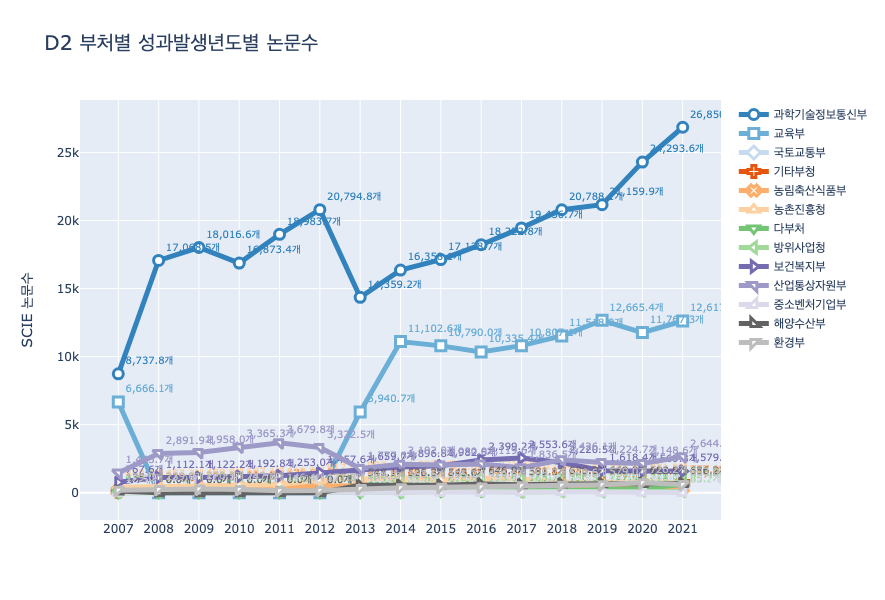

In [70]:
fig2 = bgp.make_graph_line(df1, precision=1, unit='개', 
                    node_size=10, 
                    title='D2 부처별 성과발생년도별 논문수', title_font_size=20, 
                    yaxes_title='SCIE 논문수', line_width=5, 
                    color_map='tab20c', 
                    marker_color="#ffffff",
                    marker_line_width=3,
                    cagr=False, text_cagr_font_size=12,
                    figsize=(800,600))
fig2

* 


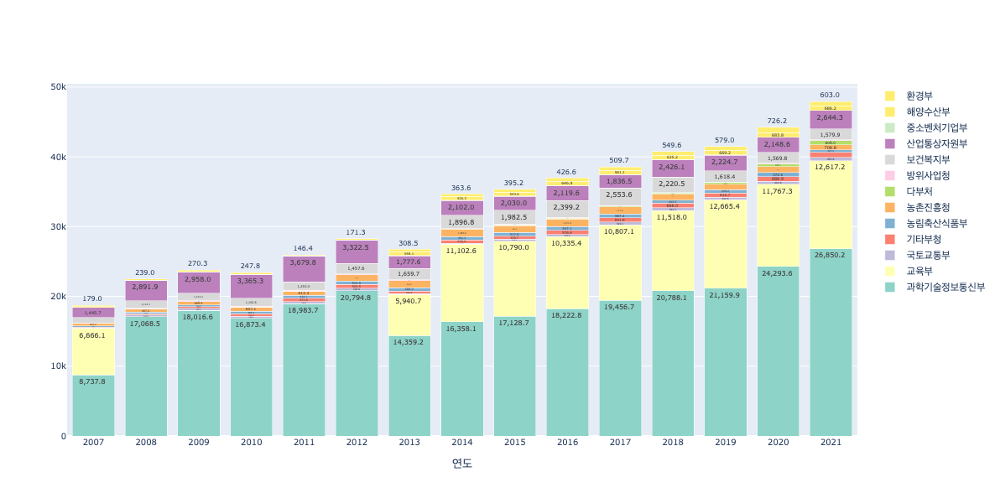

In [77]:
fig = bgp.make_graph_bar2(df=df1.T,
                               title=f"",
                               title_font_size=10,
                               unit=' ',
                               precision=1,
                               yaxes_title='',
                               xaxes_title='연도',
                               color_map='Set3',
                               textfont_size=8,
                               to_percent=False,
                               )
fig

* 


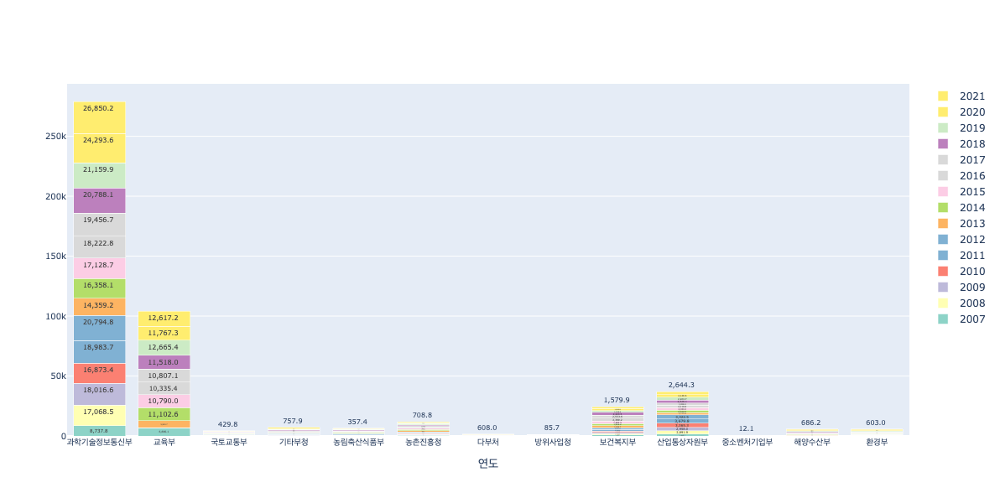

In [80]:
fig = bgp.make_graph_bar2(df=df1,
                               title=f"",
                               title_font_size=10,
                               unit=' ',
                               precision=1,
                               yaxes_title='',
                               xaxes_title='연도',
                               color_map='Set3',
                               textfont_size=8,
                               to_percent=False,
                               )
fig

* 


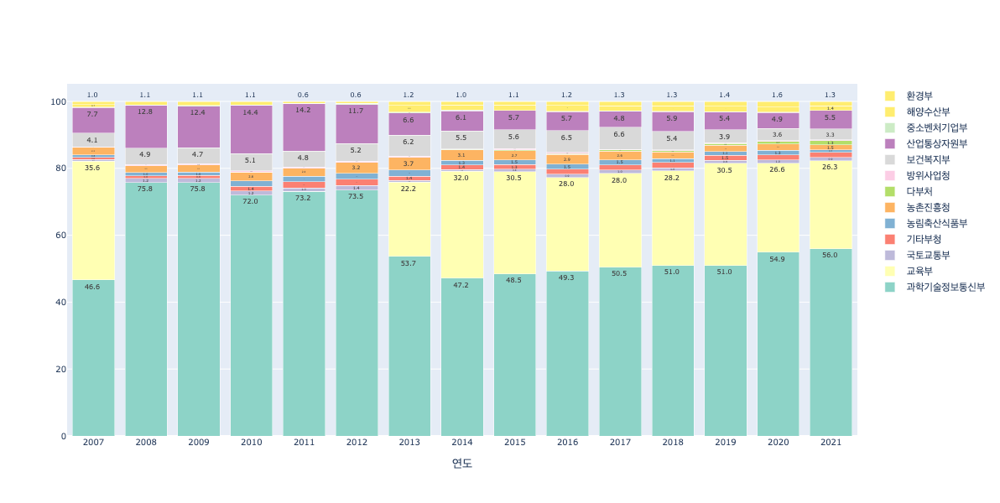

In [79]:
fig = bgp.make_graph_bar2(df=df1.T,
                               title=f"",
                               title_font_size=10,
                               unit=' ',
                               precision=1,
                               yaxes_title='',
                               xaxes_title='연도',
                               color_map='Set3',
                               textfont_size=8,
                               to_percent=True,
                               )
fig